<a href="https://colab.research.google.com/github/mvidela31/IDS/blob/master/Capsula_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Cápsula #3: Generative Adversarial Networks
#### EL7014 Teoría de la Información: Fundamentos y Aplicaciones <br> Information and Decision Systems Group

En la presente cápsula se presentan los fundamentos teóricos y ejemplos experimentales de los modelos [GAN](https://arxiv.org/pdf/1406.2661.pdf) (Goodfellow et al., 2014) e [InfoGAN](https://arxiv.org/pdf/1606.03657.pdf) (Chen et al., 2017).

In [ ]:
import os
import time
import glob
import imageio
import torch
import torch.nn as nn
import torch.optim as optim
import torch.autograd as autograd
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from IPython.display import Image
from torch.utils.data import DataLoader
from torchvision.utils import save_image
from torchvision import datasets, transforms

In [ ]:
# Datasets
MNIST_dataset = datasets.MNIST('.', transform=transforms.ToTensor(), download=True)
FashionMNIST_dataset = datasets.FashionMNIST('.', transform=transforms.ToTensor(), download=True)

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw
Processing...
Done!




/pytorch/torch/csrc/utils/tensor_numpy.cpp:141: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program.


Extracting ./FashionMNIST/raw/train-images-idx3-ubyte.gz to ./FashionMNIST/raw


Extracting ./FashionMNIST/raw/train-labels-idx1-ubyte.gz to ./FashionMNIST/raw


Extracting ./FashionMNIST/raw/t10k-images-idx3-ubyte.gz to ./FashionMNIST/raw


Extracting ./FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to ./FashionMNIST/raw
Processing...
Done!


## 1\. Generative Adversarial Nets

Se propone una estrategia para entrenar modelos generativos mediante un proceso adversario en el cual se entrenan simultáneamente un modelo generativo $G$ y un modelo discriminativo $D$. 

El modelo generativo $G$ busca capturar la distribución $p_{data}$ de un conjunto de datos, mientras que el modelo discriminativo $D$ estima la probabilidad de que una muestra provenga del conjunto de datos de entrenamiento $x\sim p_{data}$ o del modelo generativo $x\sim p_g$.

Para aprender la distribución del modelo generativo $p_g$ sobre los datos $x$ se define un prior sobre una variable de ruido de entrada $z\sim p_z$, sobre la cual se realiza un mapeo $G(z;\theta_g)$ al espacio de los datos, con $G$ una función diferenciable parametrizada por una red neuronal de parámetros $\theta_g$ (Generador). Adicionalmente se define una función escalar $D(x;\theta_d)$ parametrizada por una segunda red neuronal de parámetros $\theta_d$ (Discriminador) la cual determina la probabilidad de que una muestra provenga de las distribuciones $p_{data}$ ó $p_g$.


>![GAN Diagram](https://www.cfml.se/img/blog/generative_adversarial_networks/counterfeiter_vs_cop.jpg)

Se entrena el modelo $D$ para maximizar la probabilidad de asignar la etiqueta correcta tanto a las muestras de entrenamiento $x\sim p_{data}$, como a las muestras sintéticas $G(z)\sim p_g$. Simultáneamente, se entrena el modelo $G$ para minimizar la correcta identificación de muestras sintéticas por parte del modelo discriminativo $D$, es decir, se entrena $G$ para engañar a $D$.

De este modo, el proceso de entrenamiento corresponde a un juego *minimax* con una función de valor $V(G,D)$:

\begin{equation}
\min\limits_{G}\max\limits_{D}V(D,G)=\mathbb{E}_{x\sim p_{data}}[\log{D(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})]
\end{equation}

Se observa que en el caso óptimo, las muestras sintéticas generadas deben resultar indistinguibles de las muestras reales, es decir, $p_g=p_{data}$.


### 1.1. Fundamentos Teóricos

#### 1.1.1. Deducción de Problema de Optimización

La función de valor $V(G,D)$ se basa en la optimización de la correcta clasificación del modelo discriminativo $D$.

Sea $p$ la distribución de probabilidad real de los datos y $q$ la distribución probabilidad estimada del modelo de clasificación, se define el problema de clasificación binario asignando a las muestras reales $x\sim p_{data}$ la etiqueta $y=1$ y a las muestras sintéticas $x\sim p_{g}$ la etiqueta $y=0$. Se desea minimizar la ***entropía cruzada*** entre la distribución real $p$ y la estimada $q$:

\begin{equation}
 H(p,q)=-\mathbb{E}_p[\log{q}]\approx-\frac{1}{N}\sum_{i=1}^{N}y_i\cdot \log{\hat{y}_i}+(1-y_i)\cdot \log{(1-\hat{y}_i)}
\end{equation}

con $\hat{y}=D(x)$. Se observa que minimizar $H(p,q)$ equivale a minimizar $D_{KL}(p||q)$, y por ende, a maximizar la similitud entre la distribución real $p$ de los datos y la distribución $q$ estimada en el problema de clasificación.

El proceso de entrenamiento adversario busca que el modelo discriminativo $D$ sea capaz de reconocer las muestras reales $x\sim p_{data}$, por tanto, **se maximiza el término correspondiente a la clase positiva** ($y=1$) de la expresión de entropía cruzada:

\begin{equation}
  \mathbb{E}_{x\sim p_{data}}[\log{D(x)}]
\end{equation}

Adicionalmente, el modelo discriminativo $D$ debe también ser capaz de reconocer las muestras sintéticas $x\sim p_{g}$, por tanto, **se maximiza el término correspondiente a la clase negativa** ($y=0$) de la expresión de entropía cruzada:

\begin{equation}
  \mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})]
\end{equation}

Simultáneamente, se busca que el modelo generativo $G$ sea capaz de engañar al modelo discriminativo $D$, es decir, se busca minimizar la correcta clasificación de las muestras sintéticas $x\sim p_g$, por tanto, **se minimiza el término correspondiente a la clase negativa** ($y=0$) de la expresión de entropía cruzada:

\begin{equation}
  \mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})]
\end{equation}

Combinando las expresiones anteriores se obtiene que el problema de optimización a resolver resulta:

\begin{equation}
\min\limits_{G}\max\limits_{D}V(D,G)=\mathbb{E}_{x\sim p_{data}}[\log{D(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})]
\end{equation}


#### 1.1.2. Optimalidad Global

A continuación se demostrará que el juego minimax $\min\limits_{G}\max\limits_{D} V(D,G)$ alcanza el óptimo si, y sólo si, $p_g=p_{data}$.

En primer lugar, se busca obtener el discriminador óptimo $D^*_G$ dado un generador $G$. Recordando que el criterio de optimización para un discriminador $D$ dado un generador $G$ consiste en maximizar el término $V(G,D)$:

\begin{equation}
\begin{split}
  D^*_G(x)&=\underset{D}{\operatorname{arg max}}V(G,D)\\&=\underset{D}{\operatorname{arg max}}\mathbb{E}_{x\sim p_{data}}[\log{D(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D(G(z))})]\\
  &=\underset{D}{\operatorname{arg max}}\int_x p_{data}(x)\log{(D(x))}dx+\int_z p_z(z)\log{(1-D(G(z))dz}\\
        &=\underset{D}{\operatorname{arg max}}\int_x p_{data}(x)\log{(D(x))}dx+\int_x p_g(x)\log{(1-D(x))}dx \;\;\;\; (\mathbf{*})\\
        &=\underset{D}{\operatorname{arg max}}\int_x p_{data}(x)\log{(D(x))}+p_g(x)\log{(1-D(x))}dx\\
        &=\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}
\end{split}
\end{equation}

con $supp(D)=supp(p_{data})\cup supp(p_g)$. La última igualdad se tiene debido a que, para cualquier $(a,b)\in \mathbb{R}^2\setminus (0,0)$, la función $f(y)=a\log{(y)}+b\log{(1-y)}$ alcanza su máximo en el intervalo $[0,1]$ en el valor $y^*=\frac{a}{a+b}$. En $(*)$ se utilizó el *teorema de Radon-Nikodym*.


Sea $C(G)=\max\limits_{D} V(G,D)$, se observa que $\min\limits_{G}C(G)=\min\limits_{G}\max\limits_{D} V(D,G)$, por lo tanto, basta demostrar que $C(G)$ alcanza su mínimo global si, y sólo si, $p_{data}=p_g$. En efecto:

\begin{equation}
\begin{split}
  C(G)&=\max\limits_{D} V(G,D) \\
      &=V(G,D^*)\\
      &=\mathbb{E}_{x\sim p_{data}}[\log{D^*(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D^*(G(z))})] \\
      &=\mathbb{E}_{x\sim p_{data}}[\log{D^*(x)}]+\mathbb{E}_{x\sim p_{g}}[\log({1-D^*(x)})] \\
      &=\mathbb{E}_{x\sim p_{data}}\bigg[\log{\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}}\bigg]+\mathbb{E}_{x\sim p_{g}}\bigg[\log{\dfrac{p_{g}(x)}{p_{data}(x)+p_g(x)}}\bigg] \\
      &=\int_x p_{data}(x)\log{\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}}dx+\int_x p_g(x)\log{\dfrac{p_{g}(x)}{p_{data}(x)+p_g(x)}}dx \\
      &=\int_x \bigg[p_{data}(x)\log{\dfrac{p_{data}(x)}{p_{data}(x)+p_g(x)}}+\log{2}\bigg]dx+\int_x \bigg[p_g(x)\log{\dfrac{p_{g}(x)}{p_{data}(x)+p_g(x)}}+\log{2}\bigg]dx-\log{4} \\
      &=\int_x p_{data}(x)\log{\dfrac{p_{data}(x)}{\frac{p_{data}(x)+p_g(x)}{2}}}dx+\int_x p_g(x)\log{\dfrac{p_{g}(x)}{\frac{p_{data}(x)+p_g(x)}{2}}}dx-\log{4} \\
      &=D_{KL}\bigg(p_{data}(x)\bigg|\bigg|\frac{p_{data}(x)+p_g(x)}{2}\bigg)+D_{KL}\bigg(p_{g}(x)\bigg|\bigg|\frac{p_{data}(x)+p_g(x)}{2}\bigg)-\log{4} \\
      &=2\cdot \underbrace{D_{JSD}(p_{data}||p_{g})}_{\geq 0}-\log{4}
\end{split}
\end{equation}

Luego, el mínimo global de $C(G)$ se alcanza $\iff p_g=p_{data}$, con $\min\limits_{G}C(G)=-\log{4}$.    $_\blacksquare$

#### 1.1.3. Convergencia Algorítmica

En la práctica, se propone optimizar $\min\limits_{G}\max\limits_{D} V(D,G)$ mediante el **método de gradiente descendente**, intercalando la actualización del discriminador $D$ y el generador $G$ mediante el siguiente algoritmo:
>![GAN Algorithm](https://machinelearningmastery.com/wp-content/uploads/2019/05/Summary-of-the-Generative-Adversarial-Network-Training-Algorithm-1024x669.png)

Por lo que debemos mostrar que la optimización de dicho algoritmo converge a $p_g=p_{data}$.

Basta probar que, *dados un generador $G$ y un discriminador $D$ de **suficiente capacidad** tales que, a cada paso del **algoritmo 1**, el discriminador puede alcanzar su óptimo $D_G^*$ dado $G$, y $p_g$ es actualizado bajo el criterio:*

\begin{equation}
U(p_g,D)=\mathbb{E}_{x\sim p_{data}}[\log{D_G^*(x)}]+\mathbb{E}_{z\sim p_{z}}[\log({1-D^*_G(G(z))})]
\end{equation}

*entonces,* $p_g=p_{data}$.
 
La demostración descansa en que ***las subderivadas del supremo de funciones convexas incluyen a la derivada de la función en el punto donde se alcanza el máximo***, es decir, sea $f_\alpha(x)$ una función convexa en $x$ para todo $\alpha$ y $f(x)=\sup_{\alpha \in \mathcal{A}}f_\alpha (x)$, entonces $\partial f_\beta (x)\in \partial f$, con $\beta=\operatorname{arg sup}_{\alpha \in \mathcal{A}}f_\alpha (x)$. Notando que $U(p_g,D)$ es una función convexa con respecto a $p_g$ y asociando los términos del problema con el teorema anterior, observamos que $f_\alpha(x)=U_D(p_g)$, $f(x)=C(p_g)=\sup_D U_D(p_g)$ y $\beta=D^*=\operatorname{arg sup}_D U_D(p_g)$, luego $\partial U_{D^*}(p_g) \in \partial \sup_D U_D(p_g)$.
>![GAN saddle point](https://miro.medium.com/max/1080/1*GruVKiaBl5YKJNwdBfgGuA.png)
>![GAN saddle point at fixed D*](https://miro.medium.com/max/564/1*NWT-jEde2goyqZSXwYYLNg.png)

Se observa que el resultado anterior es equivalente a actualizar $p_g$ mediante gradiente descendente dado un discriminador $D$ óptimo, y notando además que $\sup_D U(p_g,D)$ es convexo en $p_g$ con un valor óptimo único, entonces con actualizaciones suficientemente pequeñas de $p_g$, la distribución del generador converge a la distribución de los datos, es decir, $p_g=p_{data}$.    $_\blacksquare$

* **<ins>Observación</ins>:** El generador es 
parametrizado mediante $G(z;\theta_g)$ y la optimización es realizada sobre $\theta_g$ en vez de $p_g$ directamente. El *teorema de aproximación universal* sugiere utilizar una red neuronal para parametrizar $G(z;\theta_g)$ debido a su gran capacidad de representatividad, sin embargo, esto introduce múltiples puntos críticos en el espacio de parámetros, por lo cual, no se tiene garantía teórica de la convergencia del **algoritmo 1**.

### 1.2. Experimentos

In [ ]:
# Models
class Discriminator(nn.Module):
  '''Discriminator network architecture'''  
  def __init__(self):
    super(Discriminator, self).__init__()
    self.convBlock = nn.Sequential(
      nn.Conv2d(in_channels=1, out_channels=64, kernel_size=4, stride=2, padding=1),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=128, out_channels=1024, kernel_size=7, bias=False),
      nn.BatchNorm2d(num_features=1024),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=1),
      nn.Sigmoid()
    )
  
  def forward(self, x):
    output = self.convBlock(x).view(-1, 1)
    return output

class Generator(nn.Module):
  '''Generator network architecture'''
  def __init__(self):
    super(Generator, self).__init__()
    self.deconvBlock = nn.Sequential(
      nn.ConvTranspose2d(in_channels=62, out_channels=1024, kernel_size=1, stride=1, bias=False),
      nn.BatchNorm2d(num_features=1024),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=1024, out_channels=128, kernel_size=7, stride=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=64),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=64, out_channels=1, kernel_size=4, stride=2, padding=1, bias=False),
      nn.Sigmoid()
    )

  def forward(self, x):
    output = self.deconvBlock(x)
    return output

def weights_init(m):
  '''Models parameters initializer'''
  if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
    nn.init.normal_(m.weight, mean=0.0, std=0.02)
  elif isinstance(m, (nn.BatchNorm2d)):
    nn.init.normal_(m.weight, mean=1.0, std=0.02)
    nn.init.constant_(m.bias, val=0)

#### 1.2.1. Conjunto de Datos MNIST

In [ ]:
# Dataloader
batch_size = 100
dataloader = DataLoader(MNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
D_net = Discriminator().cuda()

# Models weights initialization
G_net.apply(weights_init)
D_net.apply(weights_init)

# Loss function
binary_cross_entropy = nn.BCELoss().cuda()

# Optimizers
D_optimizer = optim.Adam(D_net.parameters(), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(G_net.parameters(), lr=1e-3, betas=(0.5, 0.99))

# Tensors
label = torch.FloatTensor(batch_size, 1).cuda()
noise = torch.FloatTensor(batch_size, 62).cuda()

# Fixed Noise Tensor (for visualization)
fixed_noise = torch.FloatTensor(100, 62).cuda()
fixed_noise.uniform_(-1, 1)
fixed_noise = fixed_noise.view(-1, 62, 1, 1)

# Train Losses (for visualization)
D_loss = []
G_loss = []

# Images Folder (for visualization)
folder_path = './imgs_MNIST'
if not os.path.exists(folder_path):
    os.makedirs(folder_path)

# First sample generation (for visualization)
cnt = 1000
G_net.eval()
save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
G_net.train()

# Training Loop
epochs = 2
pbar = tqdm(total=len(dataloader) * epochs)
for epoch in range(epochs):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    noise.uniform_(-1, 1)
    noise = noise.view(-1, 62, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(true_sample)
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(noise)
    fake_pred = D_net(fake_sample.detach())
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    # Discriminator loss
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator optimization
    G_optimizer.zero_grad()
    label.fill_(1)
    fake_pred = D_net(fake_sample)
    generator_loss = binary_cross_entropy(fake_pred, label)
    generator_loss.backward()
    G_optimizer.step()
    ### Summary
    if (i % 10) == 0:
      cnt += 1
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      #print('Iter: {} | Discriminator Loss: {} | Generator Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1]))
      G_net.eval()
      save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
      G_net.train()
      pbar.update(10)
pbar.close()
GAN_generator_MNIST = G_net

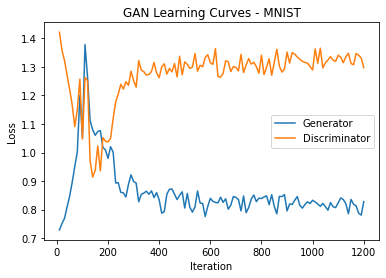

In [ ]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('GAN Learning Curves - MNIST')
plt.show()

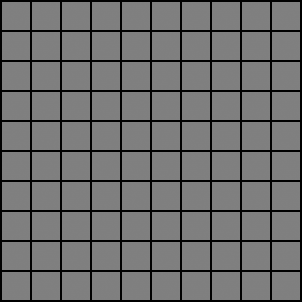

In [ ]:
# Training generated samples
filenames = glob.glob(folder_path + "/*.png")
filenames.sort()
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('./GAN_MNIST.gif', images)
with open('./GAN_MNIST.gif','rb') as f:
    display(Image(data=f.read(), format='png'))

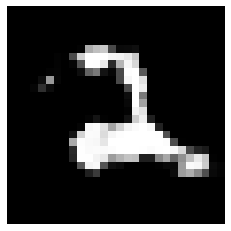

In [ ]:
# Samples generation
GAN_generator_MNIST.eval()
test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = torch.FloatTensor(test_noise).view(1,62,1,1).cuda()
generated_img = GAN_generator_MNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

#### 1.2.2. Conjunto de Datos FashionMNIST

In [ ]:
# Dataloader
batch_size = 100
dataloader = DataLoader(FashionMNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
D_net = Discriminator().cuda()

# Models weights initialization
G_net.apply(weights_init)
D_net.apply(weights_init)

# Loss function
binary_cross_entropy = nn.BCELoss().cuda()

# Optimizers
D_optimizer = optim.Adam(D_net.parameters(), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(G_net.parameters(), lr=1e-3, betas=(0.5, 0.99))

# Tensors
label = torch.FloatTensor(batch_size, 1).cuda()
noise = torch.FloatTensor(batch_size, 62).cuda()

# Fixed Noise Tensor (for visualization)
fixed_noise = torch.FloatTensor(100, 62).cuda()
fixed_noise.uniform_(-1, 1)
fixed_noise = fixed_noise.view(-1, 62, 1, 1)

# Train Losses (for visualization)
D_loss = []
G_loss = []

# Images Folder (for visualization)
folder_path = './imgs_FashionMNIST'
if not os.path.exists(folder_path):
    os.makedirs(folder_path)

# First sample generation (for visualization)
cnt = 1000
G_net.eval()
save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
G_net.train()

# Training Loop
epochs = 2
pbar = tqdm(total=len(dataloader) * epochs)
for epoch in range(epochs):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    noise.uniform_(-1, 1)
    noise = noise.view(-1, 62, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(true_sample)
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(noise)
    fake_pred = D_net(fake_sample.detach())
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    # Discriminator loss
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator optimization
    G_optimizer.zero_grad()
    label.fill_(1)
    fake_pred = D_net(fake_sample)
    generator_loss = binary_cross_entropy(fake_pred, label)
    generator_loss.backward()
    G_optimizer.step()
    ### Summary
    if (i % 10) == 0:
      cnt += 1
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      #print('Iter: {} | Discriminator Loss: {} | Generator Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1]))
      G_net.eval()
      save_image(G_net(fixed_noise), folder_path + '/img_{}.png'.format(cnt), nrow=10)
      G_net.train()
      pbar.update(10)
pbar.close()
GAN_generator_FashionMNIST = G_net

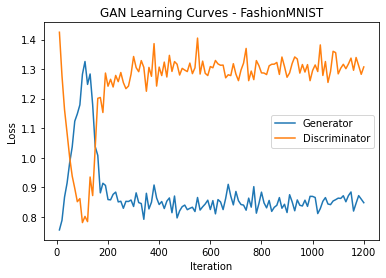

In [ ]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('GAN Learning Curves - FashionMNIST')
plt.show()

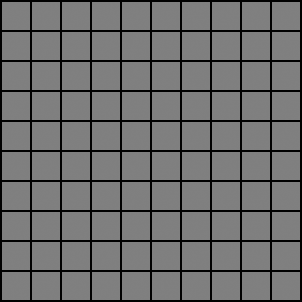

In [ ]:
# Training generated samples
filenames = glob.glob(folder_path + "/*.png")
filenames.sort()
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave('./GAN_FashionMNIST.gif', images)
with open('./GAN_FashionMNIST.gif','rb') as f:
    display(Image(data=f.read(), format='png'))

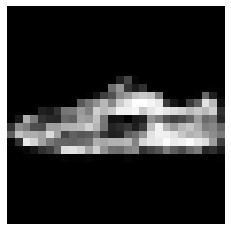

In [ ]:
# Samples generation
GAN_generator_FashionMNIST.eval()
test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = torch.FloatTensor(test_noise).view(1,62,1,1).cuda()
generated_img = GAN_generator_FashionMNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

## 2\. InfoGAN: Interpretable Representation Learning by Information Maximizing Generative Adversarial Nets

El modelo InfoGAN consiste en una red neuronal generativa adversaria (GAN) que adicionalmente maximiza la información mutua entre un conjunto de variables latentes y las muestras sintéticas generadas para tener control de las características semánticas de estas últimas.

El modelo GAN utiliza un vector de ruido continuo factorizado $z\sim p_z$ sin imponer ninguna restricción a la forma en que el modelo $G$ utiliza dicho ruido para generar muestras en el espacio de los datos. En consecuencia, el ruido es utilizado de manera altamente acoplada, por lo cual, las dimensiones individuales del vector de ruido $z$ no corresponden a características semánticas de las muestras sintéticas.

Para controlar características semánticas de las muestras sintéticas, se adiciona como entrada al generador un conjunto de variables latentes estructuradas $c_1,c_2,...,c_L$ de distribución factorizada $P(c_1,c_2,...,c_L)=\prod_{i=1}^L P(c_i)$, maximizando la información mutua entre el código latente $c$ y la muestra sintética generada $G(z,c)$, es decir, se maximiza el término $I(c;G(z,c))$.

De este modo, el juego *minimax* a resolver resulta:

\begin{equation}
  \min\limits_{G}\max\limits_{D}V_I(D,G)=V(D,G)-\lambda I(c;G(z,c))
\end{equation}

con $V(D,G)$ el término de valor del juego *minimax* del modelo GAN y $\lambda$ un término de regularización.

Se observa que el término de información $I(c;G(z,c))$ de maximizar debido a que requiere acceso a la distribución posterior $P(c|x)$, por tanto, se propone un enfoque variacional para aproximar dicha distribución mediante una distribución auxiliar $Q(c|x)$ simple de calcular parametrizada mediante una red neuronal. 

>![InfoGAN Architecture](https://www.researchgate.net/profile/Wei_Chen362/publication/334009792/figure/fig1/AS:807400315572224@1569510644357/Architectures-of-the-standard-GAN-and-the-InfoGAN.ppm)

### 2.1. Fundamentos Teóricos

#### 2.1.1. Maximización Variacional de la Información Mutua

Debido a la dificultad de cálculo del término $P(c|x)$, se busca encontrar una cota inferior del término $I(c;G(z,c))$ utilizando una distribución auxiliar $Q(c|x)$. De este modo, se tiene que:

\begin{equation}
\begin{split}
  I(c;G(z,c))\geq\mathbb{E}_{z\sim P(z)}[\mathbb{E}_{c\sim P(c)}[\mathbb{E}_{x\sim P(x|z,c)}[\log{Q(c|x)}]]]:=L_I(G,Q)
\end{split}
\end{equation}

Se observa que el término $L_I(G,Q)$ resulta simple de aproximar mediante *simulación de Monte Carlo*, pudiendo maximizarse con respecto a $Q$ directamente y con respecto a $G$ utilizando el *truco de reparametrización*.

Por lo tanto, el término $L_I(G,Q)$ puede ser añadido directamente al juego *minimax* del modelo GAN como término variacional regularizado de la información mutua, resultando la siguiente expresión:

\begin{equation}
  \min\limits_{G,Q}\max\limits_{D}V_{\text{InfoGAN}}(D,G,Q)=V(D,G)-\lambda L_{I}(G,Q)
\end{equation}

* **<u>Nota</u>:** Los detalles de la deducción e interpretación de la cota inferior de la información mutua $L_I(G,Q)$ serán cubiertos en la tarea.

### 2.2. Experimentos

In [ ]:
# Models
class DiscriminatorAndRecognitionNet(nn.Module):
  '''Discriminator and recognition network mutual architecture (parameters sharing)'''
  def __init__(self):
    super(DiscriminatorAndRecognitionNet, self).__init__()
    self.main = nn.Sequential(
      nn.Conv2d(in_channels=1, out_channels=64, kernel_size=4, stride=2, padding=1),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
      nn.Conv2d(in_channels=128, out_channels=1024, kernel_size=7, bias=False),
      nn.BatchNorm2d(num_features=1024),
      nn.LeakyReLU(negative_slope=0.1, inplace=True),
    )

  def forward(self, x):
    output = self.main(x)
    return output


class Discriminator(nn.Module):
  '''Discriminator network front architecture''' 
  def __init__(self):
    super(Discriminator, self).__init__()
    self.main = nn.Sequential(
      nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=1),
      nn.Sigmoid()
    )
    
  def forward(self, x):
    output = self.main(x).view(-1, 1)
    return output


class RecognitionNet(nn.Module):
  '''Recognition network (Q) front architecture'''
  def __init__(self):
    super(RecognitionNet, self).__init__()
    self.conv = nn.Sequential(
        nn.Conv2d(in_channels=1024, out_channels=128, kernel_size=1, bias=False),
        nn.BatchNorm2d(num_features=128),
        nn.LeakyReLU(negative_slope=0.1, inplace=True)
    )
    self.convDiscrete = nn.Conv2d(in_channels=128, out_channels=10, kernel_size=1)
    self.convContinuous_mean = nn.Conv2d(in_channels=128, out_channels=2, kernel_size=1)
    self.convContinupus_var = nn.Conv2d(in_channels=128, out_channels=2, kernel_size=1)

  def forward(self, x):
    x = self.conv(x)
    logits = self.convDiscrete(x).squeeze()
    mean = self.convContinuous_mean(x).squeeze()
    variance = self.convContinupus_var(x).squeeze().exp()
    return logits, mean, variance 


class Generator(nn.Module):
  '''Generator network architecture''' 
  def __init__(self):
    super(Generator, self).__init__()
    self.deconv = nn.Sequential(
      nn.ConvTranspose2d(in_channels=74, out_channels=1024, kernel_size=1, stride=1, bias=False),
      nn.BatchNorm2d(1024),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=1024, out_channels=128, kernel_size=7, stride=1, bias=False),
      nn.BatchNorm2d(num_features=128),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4, stride=2, padding=1, bias=False),
      nn.BatchNorm2d(num_features=64),
      nn.ReLU(inplace=True),
      nn.ConvTranspose2d(in_channels=64, out_channels=1, kernel_size=4, stride=2, padding=1, bias=False),
      nn.Sigmoid()
    )

  def forward(self, x):
    output = self.deconv(x)
    return output

def weights_init(m):
  '''Models parameters initialization'''
  if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
    nn.init.normal_(m.weight, mean=0.0, std=0.02)
  elif isinstance(m, (nn.BatchNorm2d)):
    nn.init.normal_(m.weight, mean=1.0, std=0.02)
    nn.init.constant_(m.bias, val=0)

class GaussianNLL():
  '''Independant Gaussian Negative Log-likelihood'''
  def __call__(self, x, mu, var):
    logli = -0.5 * (var.mul(2 * np.pi) + 1e-6).log() - (x - mu).pow(2).div(var.mul(2.0) + 1e-6)
    nll = logli.sum(1).mean().mul(-1)
    return nll

#### 2.2.1. Conjunto de Datos MNIST

In [ ]:
# Dataset
batch_size = 100
dataloader = DataLoader(MNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
DQ_mutual_net = DiscriminatorAndRecognitionNet().cuda()
D_net = Discriminator().cuda()
Q_net = RecognitionNet().cuda()

# Models weights initialization
G_net.apply(weights_init)
DQ_mutual_net.apply(weights_init)
D_net.apply(weights_init)
Q_net.apply(weights_init)

# Loss functions
binary_cross_entropy = nn.BCELoss().cuda()
cross_entropy = nn.CrossEntropyLoss().cuda()
gaussian_NLL = GaussianNLL()

# Optimizers
D_optimizer = optim.Adam(list(D_net.parameters()) + list(DQ_mutual_net.parameters()), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(list(G_net.parameters()) + list(Q_net.parameters()), lr=1e-3, betas=(0.5, 0.99))

# Tensors
noise = torch.FloatTensor(batch_size, 62).cuda()
categorical_code = torch.FloatTensor(batch_size, 10).cuda()
continuous_code = torch.FloatTensor(batch_size, 2).cuda()
label = torch.FloatTensor(batch_size, 1).cuda()

# Mutual information factors
lambda_cat = 1
lambda_con = 0.1

# Train Losses (for visualization)
D_loss = []
G_loss = []
I_loss = []

# Training Loop
epochs = 5
pbar = tqdm(total=len(dataloader) * epochs)
for epoch in range(epochs):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    ### Latent space and code sampling
    noise = noise.uniform_(-1, 1)
    categorical_code = categorical_code.fill_(0)
    idx_categorical_code = np.random.randint(10, size=batch_size)
    categorical_code[range(batch_size), idx_categorical_code] = 1.0
    continuous_code = continuous_code.uniform_(-1, 1)
    z = torch.cat([noise, categorical_code, continuous_code], axis=1).view(-1, 74, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(DQ_mutual_net(true_sample))
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(z)
    fake_pred = D_net(DQ_mutual_net(fake_sample.detach()))
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator & Q network optimization
    G_optimizer.zero_grad()
    # Fake sample
    label.fill_(1)
    fake_pred = D_net(DQ_mutual_net(fake_sample))
    fake_loss = binary_cross_entropy(fake_pred, label)
    # Mutual information loss
    q_logits, q_mean, q_std = Q_net(DQ_mutual_net(fake_sample))
    categorical_code_idx = torch.LongTensor(idx_categorical_code).cuda()
    info_loss = lambda_cat * cross_entropy(q_logits, categorical_code_idx) + \
                lambda_con * gaussian_NLL(continuous_code, q_mean, q_std)
    generator_loss = fake_loss + info_loss
    generator_loss.backward()
    G_optimizer.step()
    ### Summary
    if (i % 10) == 0:
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      I_loss.append(info_loss.cpu().detach().numpy().item())
      #print('Iter: {} | Discriminator Loss: {} | Generator Loss: {} | Info Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1], I_loss[-1]))
      pbar.update(10)
pbar.close()
InfoGAN_generator_MNIST = G_net

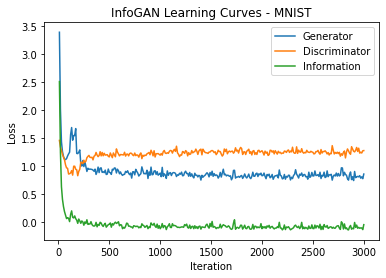

In [ ]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.plot(np.array(range(1, len(I_loss) + 1)) * 10, I_loss, label='Information')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('InfoGAN Learning Curves - MNIST')
plt.show()

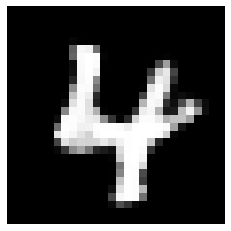

In [ ]:
#@title Samples Generation { run: "auto" }
#@markdown #### Code values:
C1 = 0 #@param {type:"slider", min:0, max:9, step:1}
C2 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
C3 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
#@markdown #### Sample new noise value:
new_noise = True #@param {type:"boolean"}
c1 = np.zeros((1,10))
c1[:,C1] = 1
c2 = np.array([[C2]])
c3 = np.array([[C3]])
InfoGAN_generator_MNIST.eval()
if new_noise:
  test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = np.hstack([test_noise, c1, c2, c3])
z_test = torch.FloatTensor(z_test).view(1,74,1,1).cuda()
generated_img = InfoGAN_generator_MNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

#### 2.2.2. Conjunto de Datos FashionMNIST

In [ ]:
# Dataset
batch_size = 100
dataloader = DataLoader(FashionMNIST_dataset, batch_size=batch_size, shuffle=True, drop_last=True)

# Models
G_net = Generator().cuda()
DQ_mutual_net = DiscriminatorAndRecognitionNet().cuda()
D_net = Discriminator().cuda()
Q_net = RecognitionNet().cuda()

# Models weights initialization
G_net.apply(weights_init)
DQ_mutual_net.apply(weights_init)
D_net.apply(weights_init)
Q_net.apply(weights_init)

# Loss functions
binary_cross_entropy = nn.BCELoss().cuda()
cross_entropy = nn.CrossEntropyLoss().cuda()
gaussian_NLL = GaussianNLL()

# Optimizers
D_optimizer = optim.Adam(list(D_net.parameters()) + list(DQ_mutual_net.parameters()), lr=2e-4, betas=(0.5, 0.99))
G_optimizer = optim.Adam(list(G_net.parameters()) + list(Q_net.parameters()), lr=1e-3, betas=(0.5, 0.99))

# Tensors
noise = torch.FloatTensor(batch_size, 62).cuda()
categorical_code = torch.FloatTensor(batch_size, 10).cuda()
continuous_code = torch.FloatTensor(batch_size, 2).cuda()
label = torch.FloatTensor(batch_size, 1).cuda()

# Mutual information factors
lambda_cat = 1
lambda_con = 0.1

# Train Losses (for visualization)
D_loss = []
G_loss = []
I_loss = []

# Training Loop
epochs = 10
pbar = tqdm(total=len(dataloader) * epochs)
for epoch in range(epochs):
  for i, batch in enumerate(dataloader, 0):
    true_sample, _ = batch
    true_sample = true_sample.cuda()
    ### Latent space and code sampling
    noise = noise.uniform_(-1, 1)
    categorical_code = categorical_code.fill_(0)
    idx_categorical_code = np.random.randint(10, size=batch_size)
    categorical_code[range(batch_size), idx_categorical_code] = 1.0
    continuous_code = continuous_code.uniform_(-1, 1)
    z = torch.cat([noise, categorical_code, continuous_code], axis=1).view(-1, 74, 1, 1)
    ### Discriminator optimization
    D_optimizer.zero_grad()
    # True sample
    label.fill_(1)
    true_pred = D_net(DQ_mutual_net(true_sample))
    true_loss = binary_cross_entropy(true_pred, label)
    true_loss.backward()
    # Fake sample
    label.fill_(0)
    fake_sample = G_net(z)
    fake_pred = D_net(DQ_mutual_net(fake_sample.detach()))
    fake_loss = binary_cross_entropy(fake_pred, label)
    fake_loss.backward()
    discriminator_loss = true_loss + fake_loss
    D_optimizer.step()
    ### Generator & Q network optimization
    G_optimizer.zero_grad()
    # Fake sample
    label.fill_(1)
    fake_pred = D_net(DQ_mutual_net(fake_sample))
    fake_loss = binary_cross_entropy(fake_pred, label)
    # Mutual information loss
    q_logits, q_mean, q_std = Q_net(DQ_mutual_net(fake_sample))
    categorical_code_idx = torch.LongTensor(idx_categorical_code).cuda()
    info_loss = lambda_cat * cross_entropy(q_logits, categorical_code_idx) + \
                lambda_con * gaussian_NLL(continuous_code, q_mean, q_std)
    generator_loss = fake_loss + info_loss
    generator_loss.backward()
    G_optimizer.step()
    ### Summary
    if (i % 10) == 0:
      D_loss.append(discriminator_loss.cpu().detach().numpy().item())
      G_loss.append(generator_loss.cpu().detach().numpy().item())
      I_loss.append(info_loss.cpu().detach().numpy().item())
      #print('Iter: {} | Discriminator Loss: {} | Generator Loss: {} | Info Loss: {}'.format(epoch * len(dataloader) + i, D_loss[-1], G_loss[-1], I_loss[-1]))
      pbar.update(10)
pbar.close()
InfoGAN_generator_FashionMNIST = G_net

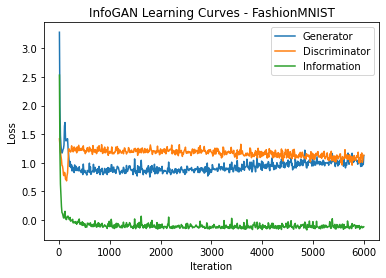

In [ ]:
# Training loss
plt.figure()
plt.plot(np.array(range(1, len(G_loss) + 1)) * 10, G_loss, label='Generator')
plt.plot(np.array(range(1, len(D_loss) + 1)) * 10, D_loss, label='Discriminator')
plt.plot(np.array(range(1, len(I_loss) + 1)) * 10, I_loss, label='Information')
plt.legend()
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.title('InfoGAN Learning Curves - FashionMNIST')
plt.show()

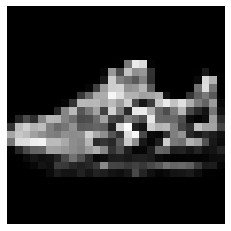

In [ ]:
#@title Samples Generation { run: "auto" }
#@markdown #### Code values:
C1 = 2 #@param {type:"slider", min:0, max:9, step:1}
C2 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
C3 = 0 #@param {type:"slider", min:-2, max:2, step:0.1}
#@markdown #### Sample new noise value:
new_noise = False #@param {type:"boolean"}
c1 = np.zeros((1,10))
c1[:,C1] = 1
c2 = np.array([[C2]])
c3 = np.array([[C3]])
InfoGAN_generator_FashionMNIST.eval()
if new_noise:
  test_noise = np.random.uniform(low=-1, high=1, size=(1,62))
z_test = np.hstack([test_noise, c1, c2, c3])
z_test = torch.FloatTensor(z_test).view(1,74,1,1).cuda()
generated_img = InfoGAN_generator_FashionMNIST(z_test)
generated_img = generated_img.cpu().detach().numpy().squeeze()
plt.figure()
plt.imshow(generated_img, cmap='gray')
plt.axis('off')
plt.show()

## 3\. Resumen



*   Se presentaron los fundamentos teóricos y ejemplos prácticos de los modelos GAN e InfoGAN.
*   Se mostró el vínculo directo de las medidas de información en los resultados teóricos del modelo GAN. 
*   Se utilizó la medida de información mutua aproximada de manera variacional para la obtención de representaciones interpretables de las muestras sintéticas generadas por dicho modelo.



## 4\. Enlaces



*   [The GAN Zoo: A list of all named GANs!](https://github.com/hindupuravinash/the-gan-zoo)
*   [Tips for Training Stable Generative Adversarial Networks](https://machinelearningmastery.com/how-to-train-stable-generative-adversarial-networks/)



## 5\. Tarea

*  [Tarea Cápsula 3](https://colab.research.google.com/drive/14ExAHsT0Q0_ObkVpnZbruUUJ5GJfMFLH?usp=sharing)